In [5]:
import numpy as np
import pandas as pd
from random import gauss
from random import randint
from random import random

import matplotlib.pyplot as plt

## Generating Normal Data

In [16]:
def Generating_Normal_Data(x, y, z, u):
    kind = x
    number_of_plots = y
    path = z
    ref_file = 'normal_' + str(kind) + '_ref_data.csv'
    fbk_file = 'normal_' + str(kind) + '_fbk_data.csv'
    
    ref_dict = dict()
    fbk_dict = dict()
    
    for i in range(number_of_plots):
        
        ref_time1 = randint(50,100)
        ref_time2 = randint(100,200)
        ref_time3 = randint(50,100)
        ref_pressure1 = [randint(5,30)]
        ref_pressure2 = [randint(150,300)]
        ref_pressure3 = [randint(5,30)]
        
        decreasing_range = randint(0,10)  #percentage
        h = (ref_pressure2[0] - ref_pressure3[0]) * (decreasing_range/100)
        t = ref_time2
        a = 1
        b = (1/t) * (np.log(1 + h/a))
        decreasing_data = [ref_pressure2[0] - a * np.exp(b * i) - a for i in range(0, t)]
    
        ref_set = ref_time1 * ref_pressure1 + decreasing_data + ref_time3 * ref_pressure3

        noise_deviation_range = randint(5,10)  #percentage
        fbk_set = [gauss(i, i * (noise_deviation_range/100) * i/(max(ref_set))) for i in ref_set]
        overshooting_range = randint(130,180)  #percentage
        fbk_set[ref_time1] = fbk_set[ref_time1] * overshooting_range/100
        
        ref_dict['ref' + str(i)] = ref_time1 * ref_pressure1 + ref_time2 * ref_pressure2 + ref_time3 * ref_pressure3
        fbk_dict['fbk' + str(i)] = fbk_set

        fig = plt.figure(figsize=(5,2))
        plt.plot(fbk_set, linewidth = 1)
        plt.xlim((0,500))
        plt.ylim((0,500))
        if u == 1:
            fig.savefig(path + str(i * 2) + '.jpg')
        else:
            fig.savefig(path + str(i) + '.jpg')
    
    ref_df = pd.DataFrame(dict([(k,pd.Series(v)) for k,v in ref_dict.items()]))
    fbk_df = pd.DataFrame(dict([(k,pd.Series(v)) for k,v in fbk_dict.items()]))
    ref_df.to_csv(ref_file, index = False)
    fbk_df.to_csv(fbk_file, index = False)

## Generating Abnormal Data

In [21]:
def Generating_Abnormal_Data(x, y, z, u):
    kind = x
    number_of_plots = y
    path = z
    ref_file = 'abnormal_' + str(kind) + '_ref_data.csv'
    fbk_file = 'abnormal_' + str(kind) + '_fbk_data.csv'
    
    ref_dict = dict()
    fbk_dict = dict()
    
    for i in range(number_of_plots):
        
        ref_time1 = randint(50,100)
        ref_time2 = randint(100,200)
        ref_time3 = randint(50,100)
        ref_pressure1 = [randint(5,30)]
        ref_pressure2 = [randint(150,300)]
        ref_pressure3 = [randint(5,30)]
        
        decreasing_range = randint(0,100)  #percentage
        h = (ref_pressure2[0] - ref_pressure3[0]) * (decreasing_range/100)
        t = ref_time2
        a = 1
        b = (1/t) * (np.log(1 + h/a))
        decreasing_data = [ref_pressure2[0] - a * np.exp(b * i) - a for i in range(0, t)]
    
        ref_set = ref_time1 * ref_pressure1 + decreasing_data + ref_time3 * ref_pressure3

        noise_deviation_range = randint(5,50)  #percentage
        fbk_set = [gauss(i, i * (noise_deviation_range/100) * i/(max(ref_set))) for i in ref_set]
        overshooting_range = randint(130,500)  #percentage
        fbk_set[ref_time1] = fbk_set[ref_time1] * overshooting_range/100
        
        ref_dict['ref' + str(i)] = ref_time1 * ref_pressure1 + ref_time2 * ref_pressure2 + ref_time3 * ref_pressure3
        fbk_dict['fbk' + str(i)] = fbk_set

        fig = plt.figure(figsize=(5,2))
        plt.plot(fbk_set, linewidth = 1)
        plt.xlim((0,500))
        plt.ylim((0,500))
        if u == 1:
            fig.savefig(path + str(i * 2 + 1) + '.jpg')
        else:
            fig.savefig(path + str(i) + '.jpg')
    
    
    ref_df = pd.DataFrame(dict([(k,pd.Series(v)) for k,v in ref_dict.items()]))
    fbk_df = pd.DataFrame(dict([(k,pd.Series(v)) for k,v in fbk_dict.items()]))
    ref_df.to_csv(ref_file, index = False)
    fbk_df.to_csv(fbk_file, index = False)

C:\Users\USER\Anaconda3\lib\site-packages\matplotlib\pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


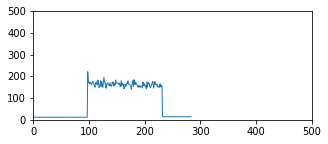

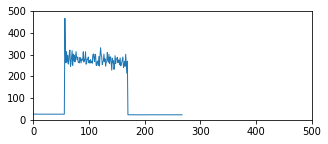

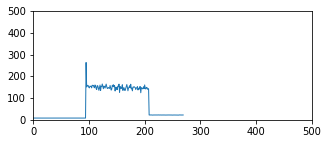

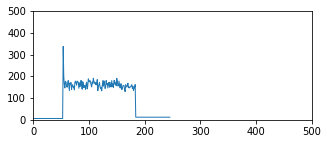

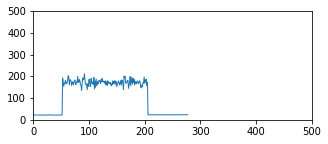

...

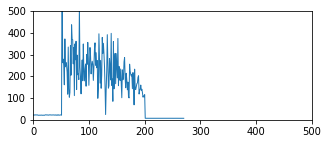

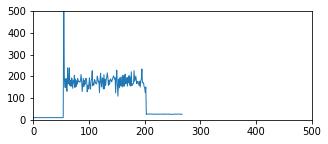

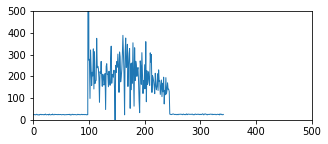

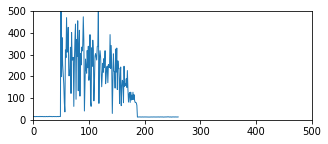

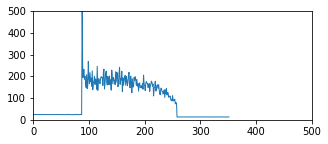

In [23]:
Generating_Normal_Data('train', 1000, './data/train/normal/', 0)
Generating_Abnormal_Data('train', 1000, './data/train/abnormal/', 0)

Generating_Normal_Data('valid', 200, './data/valid/normal/', 0)
Generating_Abnormal_Data('valid', 200, './data/valid/abnormal/', 0)

Generating_Normal_Data('test', 50, './data/test/', 1)
Generating_Abnormal_Data('test', 50, './data/test/', 1)